# Earthquake Data Overview

In [45]:
import pandas as pd
import numpy as np
import reverse_geocode

import geopandas as gpd
from geopandas import GeoDataFrame
import folium
from folium.plugins import FastMarkerCluster, MarkerCluster

import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

# plotly standard libraries
import plotly.express as px
import plotly.graph_objects as go
import chart_studio.plotly as py

# plotly wrapper cufflinks
import cufflinks as cf

# making plotly offline to use
from plotly.offline import iplot, init_notebook_mode
init_notebook_mode(connected=True)
cf.go_offline(connected=True)

In [4]:
# Read the earthquake data 

earthquake = pd.read_csv('earthquake_country_continent_cleaned_data.csv', encoding='unicode_escape')
earthquake.head()

,latitude,longitude,depth,mag,magType,net,id,place,type,date,Time,country_code,country,continent
0,41.93,20.54,10.0,4.5,mb,us,usp0009kjw,"14 km SW of Dragash, Kosovo",earthquake,2000-01-01,01:19:26,AL,Albania,Europe
1,41.92,20.53,6.2,2.9,md,us,usp0009kjx,"15 km SW of Dragash, Kosovo",earthquake,2000-01-01,02:10:15,AL,Albania,Europe
2,-11.35,164.57,33.0,4.3,mb,us,usp0009kjz,"150 km WSW of Lata, Solomon Islands",earthquake,2000-01-01,02:12:13,SB,Solomon Islands,Oceania
3,48.12,-2.96,3.0,2.7,ml,us,usp0009kk0,"2 km ESE of Neulliac, France",earthquake,2000-01-01,03:20:57,FR,France,Europe
4,62.75,-150.30,93.3,2.5,ml,ak,ak0001pgua9,"35 km NNW of Chase, Alaska",earthquake,2000-01-01,03:24:23,US,United States,North America


In [5]:
# Check for null values

earthquake.isnull().sum()

latitude         0
longitude        0
depth            0
mag              0
magType          0
net              0
id               0
place            0
type             0
date             0
Time             0
country_code    24
country          0
continent        0
dtype: int64

In [8]:
# Check unique values in "Country" column

len(earthquake.country.unique())

220

In [10]:
# Check which rows have null country code

earthquake[earthquake.country_code.isnull()]

,latitude,longitude,depth,mag,magType,net,id,place,type,date,Time,country_code,country,continent
141700,-20.27,16.45,10.00,4.1,mb,us,usp000e512,"29 km NW of Otjiwarongo, Namibia",earthquake,2005-11-27,16:14:45,NaN,Namibia,Africa
218015,-21.35,16.89,10.00,4.8,mb,us,usp000g4ww,"70 km N of Okahandja, Namibia",earthquake,2008-04-26,14:48:47,NaN,Namibia,Africa
218023,-21.37,16.78,10.00,3.8,mb,us,usp000g4x2,"68 km NNW of Okahandja, Namibia",earthquake,2008-04-26,16:11:19,NaN,Namibia,Africa
249278,-20.97,14.93,10.00,5.1,mb,us,usp000gzuu,"67 km S of Khorixas, Namibia",earthquake,2009-07-31,08:14:39,NaN,Namibia,Africa
263252,-18.38,15.96,10.00,4.0,ml,us,usp000hb6t,"50 km S of Ondangwa, Namibia",earthquake,2010-04-11,14:47:45,NaN,Namibia,Africa
266130,-24.40,15.82,10.00,4.1,ml,us,usp000hd48,"126 km WNW of Maltahöhe, Namibia",earthquake,2010-05-24,11:00:48,NaN,Namibia,Africa
308230,-20.18,14.45,10.00,4.8,mb,us,usp000jgq1,"57 km WNW of Khorixas, Namibia",earthquake,2012-03-24,04:43:51,NaN,Namibia,Africa
402289,-20.07,14.57,12.32,4.7,mb,us,us20004y45,"52 km NW of Khorixas, Namibia",earthquake,2016-02-02,19:15:01,NaN,Namibia,Africa
402320,-20.13,14.58,10.00,4.7,mb,us,us20004y57,"47 km WNW of Khorixas, Namibia",earthquake,2016-02-03,11:04:00,NaN,Namibia,Africa
413604,-27.40,6.54,10.00,4.5,mb,us,us20006hhk,South Atlantic Ocean,earthquake,2016-07-20,21:42:14,NaN,Namibia,Africa


Namibia has no country code in the dataset

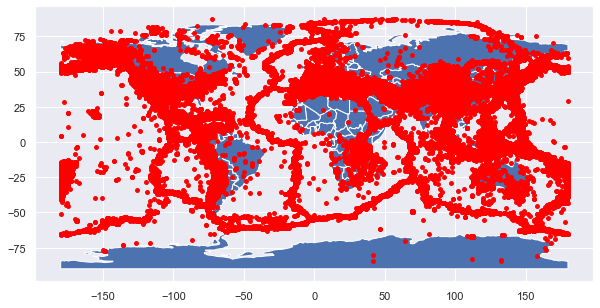

In [26]:
# Create a map with all the data points

geometry = gpd.points_from_xy(earthquake.longitude, earthquake.latitude)
gdf = GeoDataFrame(earthquake, geometry=geometry)   

world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
gdf.plot(ax=world.plot(figsize=(10, 6)), marker='o', color='red', markersize=15, figsize = (14,25));

In [31]:
# Create a dataframe with magnitude greater than 8

earthquake_mg_8 = earthquake[earthquake.mag>8]
earthquake_mg_8.head()

,latitude,longitude,depth,mag,magType,net,id,place,type,date,Time,country_code,country,continent
27832,-16.26,-73.64,33.0,8.40,mww,official,official20010623203314130_33,"6 km SSW of Atico, Peru",earthquake,2001-06-23,20:33:14,PE,Peru,South America
79640,41.82,143.91,27.0,8.16,mww,official,official20030925195006360_27,"134 km SSW of Kushiro, Japan",earthquake,2003-09-25,19:50:06,JP,Japan,Asia
112327,-49.31,161.34,10.0,8.10,mwc,us,usp000db93,north of Macquarie Island,earthquake,2004-12-23,14:59:04,NZ,New Zealand,Oceania
112500,3.30,95.98,30.0,9.10,mw,official,official20041226005853450_30,2004 Sumatra - Andaman Islands Earthquake,earthquake,2004-12-26,00:58:53,ID,Indonesia,Asia
121015,2.08,97.11,30.0,8.60,mww,official,official20050328160936530_30,"78 km WSW of Singkil, Indonesia",earthquake,2005-03-28,16:09:36,ID,Indonesia,Asia


In [32]:
# Check number of rows

earthquake_mg_8.size

294

In [44]:
# Show center of the map
# # max zoom is 7; restrict zooms not to scroll much

m = folium.Map([earthquake_mg_8['latitude'].mean(), earthquake_mg_8['longitude'].mean()],
               zoom_start=3, min_zoom = 2, max_zoom = 8)

for i in range(len(earthquake_mg_8)): # add markers for all datapoints
    folium.Marker([earthquake_mg_8.iloc[i]['latitude'], earthquake_mg_8.iloc[i]['longitude']], popup=earthquake_mg_8.iloc[i]['country']).add_to(m)
    
# Show the map
m

In [50]:
# Earthquake with magnitude greater than 5

earthquake_mg_5 = earthquake[earthquake.mag>5]
earthquake.head()

,latitude,longitude,depth,mag,magType,net,id,place,type,date,Time,country_code,country,continent
0,41.93,20.54,10.0,4.5,mb,us,usp0009kjw,"14 km SW of Dragash, Kosovo",earthquake,2000-01-01,01:19:26,AL,Albania,Europe
1,41.92,20.53,6.2,2.9,md,us,usp0009kjx,"15 km SW of Dragash, Kosovo",earthquake,2000-01-01,02:10:15,AL,Albania,Europe
2,-11.35,164.57,33.0,4.3,mb,us,usp0009kjz,"150 km WSW of Lata, Solomon Islands",earthquake,2000-01-01,02:12:13,SB,Solomon Islands,Oceania
3,48.12,-2.96,3.0,2.7,ml,us,usp0009kk0,"2 km ESE of Neulliac, France",earthquake,2000-01-01,03:20:57,FR,France,Europe
4,62.75,-150.30,93.3,2.5,ml,ak,ak0001pgua9,"35 km NNW of Chase, Alaska",earthquake,2000-01-01,03:24:23,US,United States,North America


In [51]:
# Mark earthquakes epicenters with Magnitude more than 6 using CircleMarker:

mc = MarkerCluster(name="Marker Cluster")

folium_map = folium.Map([earthquake_mg_5['latitude'].mean(), earthquake_mg_5['longitude'].mean()],
               zoom_start=3, min_zoom = 2, max_zoom = 6) 
               
# earthquake_mg_8.iloc[i]['latitude']
#earthquake_mg_8.iloc[i]['latitude'], earthquake_mg_8.iloc[i]['longitude']

for i in range(len(earthquake_mg_5)):
    
    folium.CircleMarker(location=[earthquake_mg_5.iloc[i]['latitude'], earthquake_mg_5.iloc[i]['longitude']],
                        radius= 1.5 * earthquake_mg_5.iloc[i]['mag'],
                        color="red",
                        fill=True).add_to(mc)
    
mc.add_to(folium_map)

folium.LayerControl().add_to(folium_map)
folium_map